 PART A 

In [1]:
# importing necessary librabries 

import json
import csv

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

from sklearn.decomposition import PCA
from sklearn.svm import SVC
from sklearn import model_selection
from scipy.stats import zscore

from sklearn.cluster import KMeans

from scipy.stats import zscore
from sklearn.model_selection import train_test_split

import warnings
warnings.filterwarnings('ignore')

# Question 1. Data Understanding & Exploration: [5 Marks]
#    A. Read ‘Car name.csv’ as a DataFrame and assign it to a variable. [1 Mark]
#    B. Read ‘Car-Attributes.json as a DataFrame and assign it to a variable. [1 Mark]
#    C. Merge both the DataFrames together to form a single DataFrame [2 Mark]
#    D. Print 5 point summary of the numerical features and share insights. [1 Marks]

In [2]:
#    A. Read ‘Car name.csv’ as a DataFrame and assign it to a variable. [1 Mark]

car = pd.read_csv("Car name.csv")
print("Data shape:",car.shape)
car.head()

Data shape: (398, 1)


,car_name
0,chevrolet chevelle malibu
1,buick skylark 320
2,plymouth satellite
3,amc rebel sst
4,ford torino


In [3]:
# B. Read ‘Car-Attributes.json as a DataFrame and assign it to a variable. [1 Mark]

json_file = pd.read_json("Car-Attributes.json")
json_file.head()

,mpg,cyl,disp,hp,wt,acc,yr,origin
0,18.0,8,307.0,130,3504,12.0,70,1
1,15.0,8,350.0,165,3693,11.5,70,1
2,18.0,8,318.0,150,3436,11.0,70,1
3,16.0,8,304.0,150,3433,12.0,70,1
4,17.0,8,302.0,140,3449,10.5,70,1


In [4]:
# C. Merge both the DataFrames together to form a single DataFrame [2 Mark]

cvsJsonMerge = pd.concat([car, json_file], axis=1)
cvsJsonMerge.shape


(398, 9)

In [5]:
cvsJsonMerge.head()

,car_name,mpg,cyl,disp,hp,wt,acc,yr,origin
0,chevrolet chevelle malibu,18.0,8,307.0,130,3504,12.0,70,1
1,buick skylark 320,15.0,8,350.0,165,3693,11.5,70,1
2,plymouth satellite,18.0,8,318.0,150,3436,11.0,70,1
3,amc rebel sst,16.0,8,304.0,150,3433,12.0,70,1
4,ford torino,17.0,8,302.0,140,3449,10.5,70,1


In [6]:
cvsJsonMerge.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 398 entries, 0 to 397
Data columns (total 9 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   car_name  398 non-null    object 
 1   mpg       398 non-null    float64
 2   cyl       398 non-null    int64  
 3   disp      398 non-null    float64
 4   hp        398 non-null    object 
 5   wt        398 non-null    int64  
 6   acc       398 non-null    float64
 7   yr        398 non-null    int64  
 8   origin    398 non-null    int64  
dtypes: float64(3), int64(4), object(2)
memory usage: 28.1+ KB


In [7]:
cvsJsonMerge.tail()

,car_name,mpg,cyl,disp,hp,wt,acc,yr,origin
393,ford mustang gl,27.0,4,140.0,86,2790,15.6,82,1
394,vw pickup,44.0,4,97.0,52,2130,24.6,82,2
395,dodge rampage,32.0,4,135.0,84,2295,11.6,82,1
396,ford ranger,28.0,4,120.0,79,2625,18.6,82,1
397,chevy s-10,31.0,4,119.0,82,2720,19.4,82,1


In [8]:
cvsJsonMerge.describe()

,mpg,cyl,disp,wt,acc,yr,origin
count,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000
mean,23.514573,5.454774,193.425879,2970.424623,15.568090,76.010050,1.572864
std,7.815984,1.701004,104.269838,846.841774,2.757689,3.697627,0.802055
min,9.000000,3.000000,68.000000,1613.000000,8.000000,70.000000,1.000000
25%,17.500000,4.000000,104.250000,2223.750000,13.825000,73.000000,1.000000
50%,23.000000,4.000000,148.500000,2803.500000,15.500000,76.000000,1.000000
75%,29.000000,8.000000,262.000000,3608.000000,17.175000,79.000000,2.000000
max,46.600000,8.000000,455.000000,5140.000000,24.800000,82.000000,3.000000


In [9]:
# D. Print 5 point summary of the numerical features and share insights. [1 Marks]

cvsJsonMerge.describe().T

,count,mean,std,min,25%,50%,75%,max
mpg,398.0,23.514573,7.815984,9.0,17.500,23.0,29.000,46.6
cyl,398.0,5.454774,1.701004,3.0,4.000,4.0,8.000,8.0
disp,398.0,193.425879,104.269838,68.0,104.250,148.5,262.000,455.0
wt,398.0,2970.424623,846.841774,1613.0,2223.750,2803.5,3608.000,5140.0
acc,398.0,15.568090,2.757689,8.0,13.825,15.5,17.175,24.8
yr,398.0,76.010050,3.697627,70.0,73.000,76.0,79.000,82.0
origin,398.0,1.572864,0.802055,1.0,1.000,1.0,2.000,3.0


# Question 2. Data Preparation & Analysis: [10 Marks]
#    A. Check and print feature-wise percentage of missing values present in the data and impute with the best suitable approach. [2 Mark]
#    B. Check for duplicate values in the data and impute with the best suitable approach. [1 Mark]
#    C. Plot a pairplot for all features. [1 Marks]
#    D. Visualize a scatterplot for ‘wt’ and ‘disp’. Datapoints should be distinguishable by ‘cyl’. [1 Marks]
#    E. Share insights for Q2.d. [1 Marks]
#    F. Visualize a scatterplot for ‘wt’ and ’mpg’. Datapoints should be distinguishable by ‘cyl’. [1 Marks]
#    G. Share insights for Q2.f. [1 Marks]
#    H. Check for unexpected values in all the features and datapoints with such values. [2 Marks]
#        [Hint: ‘?’ is present in ‘hp’]

In [10]:
# A. Check and print feature-wise percentage of missing values present in the data and impute with the best suitable approach. [2 Mark]

# Data types of the attributes

cvsJsonMerge.dtypes

car_name     object
mpg         float64
cyl           int64
disp        float64
hp           object
wt            int64
acc         float64
yr            int64
origin        int64
dtype: object

In [11]:
# check for null value
cvsJsonMerge.isnull().sum()

car_name    0
mpg         0
cyl         0
disp        0
hp          0
wt          0
acc         0
yr          0
origin      0
dtype: int64

In [12]:
# Original dataframe size
Original_size = cvsJsonMerge.size

# drop dataframe
cvsJsonMerge.dropna(inplace=True)

# New dataframe size
New_size=cvsJsonMerge.size

print("> Original:",Original_size,"vs","New:",New_size)

# Data drop impact analysis

Data_lost=100*((Original_size-New_size)/Original_size)
print("> Percentage of data lost",Data_lost,"%")
if Data_lost<=5:
    print("\n> Not much data has been lost,dropping data was a good option")
else:
    print("\n> Considerable data has been lost,dropping data was not a good option. We need to impute data")

> Original: 3582 vs New: 3582
> Percentage of data lost 0.0 %

> Not much data has been lost,dropping data was a good option


From above result there are no missing values so no need to drop missing values.

In [13]:
# B. Check for duplicate values in the data and impute with the best suitable approach. [1 Mark]
# i) First checking duplicate rows

cvsJsonMerge.duplicated()

0      False
1      False
2      False
3      False
4      False
       ...  
393    False
394    False
395    False
396    False
397    False
Length: 398, dtype: bool

In [14]:
# ii) SEcondly checking duplicates by columns 

cvsJsonMerge["car_name"].duplicated()

0      False
1      False
2      False
3      False
4      False
       ...  
393    False
394    False
395    False
396    False
397    False
Name: car_name, Length: 398, dtype: bool

In [15]:
cvsJsonMerge["mpg"].duplicated()

0      False
1      False
2       True
3      False
4      False
       ...  
393     True
394    False
395     True
396     True
397     True
Name: mpg, Length: 398, dtype: bool

In [16]:
cvsJsonMerge["cyl"].duplicated()

0      False
1       True
2       True
3       True
4       True
       ...  
393     True
394     True
395     True
396     True
397     True
Name: cyl, Length: 398, dtype: bool

In [17]:
cvsJsonMerge["disp"].duplicated()

0      False
1      False
2      False
3      False
4      False
       ...  
393     True
394     True
395     True
396     True
397     True
Name: disp, Length: 398, dtype: bool

In [18]:
cvsJsonMerge["hp"].duplicated()

0      False
1      False
2      False
3       True
4      False
       ...  
393     True
394     True
395     True
396     True
397    False
Name: hp, Length: 398, dtype: bool

In [19]:
cvsJsonMerge["wt"].duplicated()

0      False
1      False
2      False
3      False
4      False
       ...  
393    False
394     True
395    False
396    False
397     True
Name: wt, Length: 398, dtype: bool

In [20]:
cvsJsonMerge["acc"].duplicated()

0      False
1      False
2      False
3       True
4      False
       ...  
393    False
394    False
395    False
396     True
397     True
Name: acc, Length: 398, dtype: bool

In [21]:
cvsJsonMerge["yr"].duplicated()

0      False
1       True
2       True
3       True
4       True
       ...  
393     True
394     True
395     True
396     True
397     True
Name: yr, Length: 398, dtype: bool

In [22]:
cvsJsonMerge["origin"].duplicated()

0      False
1       True
2       True
3       True
4       True
       ...  
393     True
394     True
395     True
396     True
397     True
Name: origin, Length: 398, dtype: bool

From above results there is no duplicate rows in cvsJsonMerge dataframe .But for columns only car_name columns has no duplicate data but for  origin, yr, acc, wt, mpd ,cyl , disp and hp columns has duplicate data. 

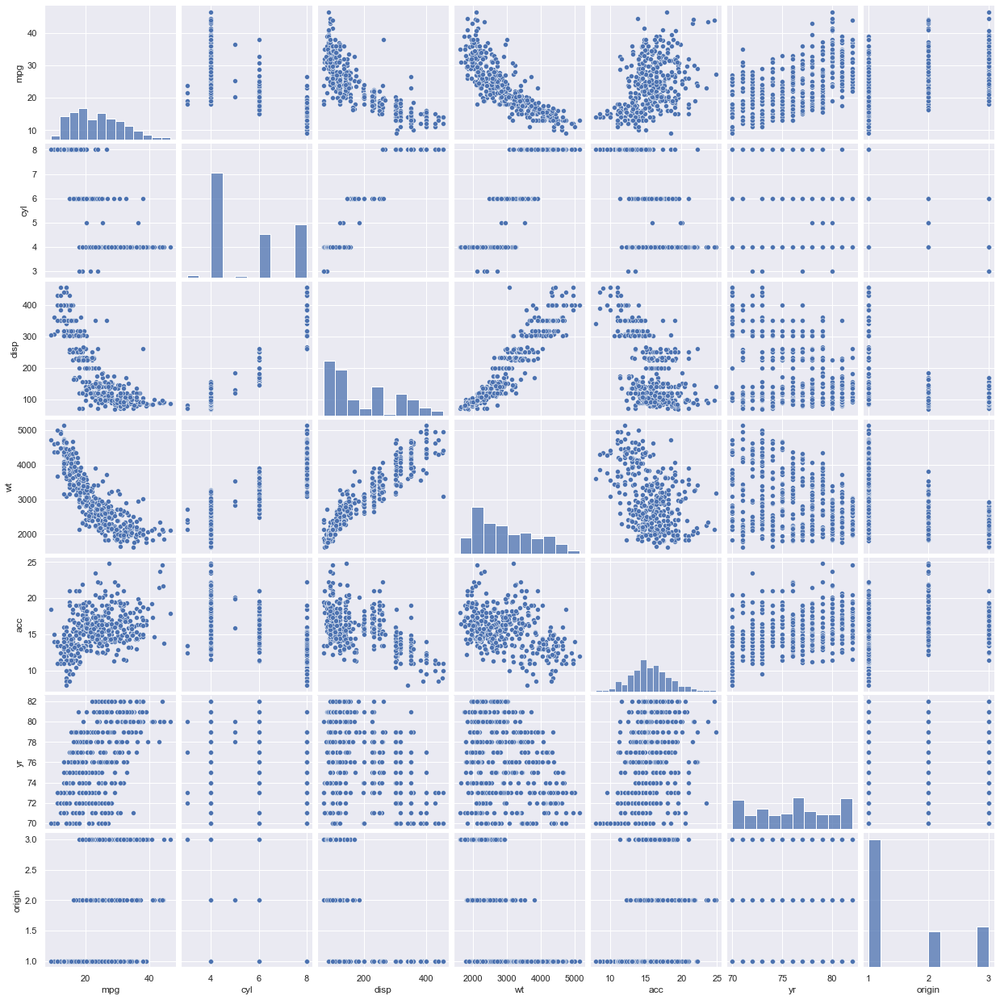

In [185]:
# C. Plot a pairplot for all features. [1 Marks]

sns.pairplot(cvsJsonMerge)

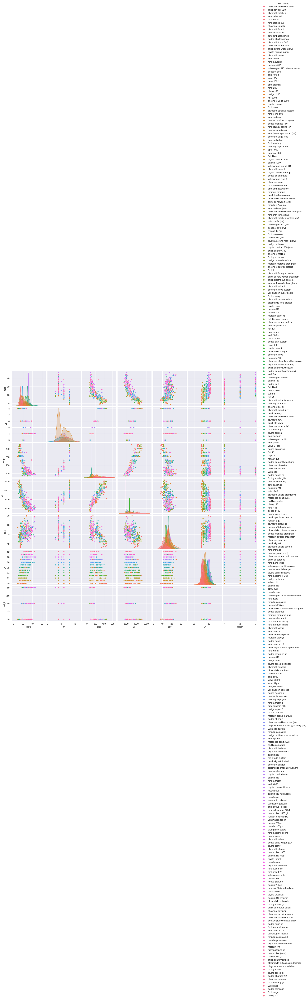

In [186]:
sns.pairplot(cvsJsonMerge, hue="car_name")


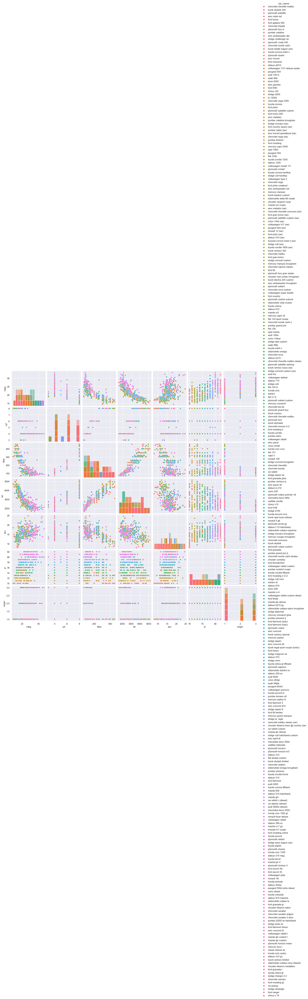

In [187]:
sns.pairplot(cvsJsonMerge, hue="car_name", diag_kind="hist")

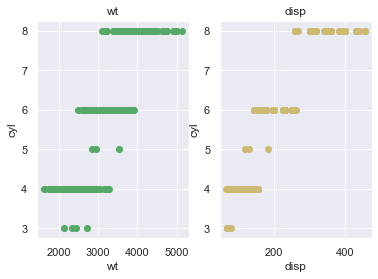

In [188]:
# D. Visualize a scatterplot for ‘wt’ and ‘disp’. Datapoints should be distinguishable by ‘cyl’. [1 Marks]

import matplotlib.pyplot as plt
fig = plt.figure()

ax1 = fig.add_subplot(121)
ax2 = fig.add_subplot(122)

ax1.scatter(data=cvsJsonMerge, x="wt", y="cyl",color = 'g')
ax2.scatter(data=cvsJsonMerge, x="disp", y="cyl",color = 'y')

ax1.set_title('wt')
ax1.set_xlabel('wt')
ax1.set_ylabel('cyl')

ax2.set_title('disp')
ax2.set_xlabel('disp')
ax2.set_ylabel('cyl')

plt.show()

# E. Share insights for Q2.d. [1 Marks]

From above observations both wt and disp are widely distributed as per there units. as wt ranges from 2000 to 5000 while disp ranges from 0 to 500. AS we are comparing both along cyl so both are widely spread.

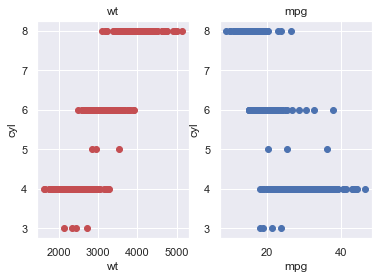

In [189]:
# F. Visualize a scatterplot for ‘wt’ and ’mpg’. Datapoints should be distinguishable by ‘cyl’. [1 Marks]

import matplotlib.pyplot as plt
fig = plt.figure()

ax1 = fig.add_subplot(121)
ax2 = fig.add_subplot(122)

ax1.scatter(data=cvsJsonMerge, x="wt", y="cyl",color = 'r')
ax2.scatter(data=cvsJsonMerge, x="mpg", y="cyl",color = 'b')

ax1.set_title('wt')
ax1.set_xlabel('wt')
ax1.set_ylabel('cyl')

ax2.set_title('mpg')
ax2.set_xlabel('mpg')
ax2.set_ylabel('cyl')

plt.show()

# G. Share insights for Q2.f. [1 Marks]

 From the above two subgraphs wt is widely distrubuted as compare to mpg. Means wt is ranges from 1000 to 5000 but for mpg value is less than 100.

In [23]:
# H. Check for unexpected values in all the features and datapoints with such values. [2 Marks]
#    [Hint: ‘?’ is present in ‘hp’]


cvsJsonMerge.describe(include='all').loc['unique', :]

car_name     305
mpg          NaN
cyl          NaN
disp         NaN
hp          94.0
wt           NaN
acc          NaN
yr           NaN
origin       NaN
Name: unique, dtype: object

In [24]:
# isdigit()? on 'horsepower' 
hpIsDigit = pd.DataFrame(cvsJsonMerge.hp.str.isdigit())  # if the string is made of digits store True else False

#print isDigit = False!
cvsJsonMerge[hpIsDigit['hp'] == False]

,car_name,mpg,cyl,disp,hp,wt,acc,yr,origin
32,ford pinto,25.0,4,98.0,?,2046,19.0,71,1
126,ford maverick,21.0,6,200.0,?,2875,17.0,74,1
330,renault lecar deluxe,40.9,4,85.0,?,1835,17.3,80,2
336,ford mustang cobra,23.6,4,140.0,?,2905,14.3,80,1
354,renault 18i,34.5,4,100.0,?,2320,15.8,81,2
374,amc concord dl,23.0,4,151.0,?,3035,20.5,82,1


In [25]:
cvsJsonMerge = cvsJsonMerge.replace('?', np.nan)
cvsJsonMerge[hpIsDigit['hp'] == False] 

,car_name,mpg,cyl,disp,hp,wt,acc,yr,origin
32,ford pinto,25.0,4,98.0,NaN,2046,19.0,71,1
126,ford maverick,21.0,6,200.0,NaN,2875,17.0,74,1
330,renault lecar deluxe,40.9,4,85.0,NaN,1835,17.3,80,2
336,ford mustang cobra,23.6,4,140.0,NaN,2905,14.3,80,1
354,renault 18i,34.5,4,100.0,NaN,2320,15.8,81,2
374,amc concord dl,23.0,4,151.0,NaN,3035,20.5,82,1


In [26]:
cvsJsonMerge['hp'] = cvsJsonMerge['hp'].median()

In [27]:
cvsJsonMerge.head()

,car_name,mpg,cyl,disp,hp,wt,acc,yr,origin
0,chevrolet chevelle malibu,18.0,8,307.0,93.5,3504,12.0,70,1
1,buick skylark 320,15.0,8,350.0,93.5,3693,11.5,70,1
2,plymouth satellite,18.0,8,318.0,93.5,3436,11.0,70,1
3,amc rebel sst,16.0,8,304.0,93.5,3433,12.0,70,1
4,ford torino,17.0,8,302.0,93.5,3449,10.5,70,1


# Question 3. Clustering: [15 Marks]
#   A. Apply K-Means clustering for 2 to 10 clusters. [3 Marks]
#   B. Plot a visual and find elbow point. [2 Marks]
#   C. On the above visual, highlight which are the possible Elbow points. [1 Marks]
#   D. Train a K-means clustering model once again on the optimal number of clusters. [3 Marks]
#   E. Add a new feature in the DataFrame which will have labels based upon cluster value. [2 Marks]
#   F. Plot a visual and color the datapoints based upon clusters. [2 Marks]
#   G. Pass a new DataPoint and predict which cluster it belongs to. [2 Marks]

In [28]:
cvsJsonMerge.head()

,car_name,mpg,cyl,disp,hp,wt,acc,yr,origin
0,chevrolet chevelle malibu,18.0,8,307.0,93.5,3504,12.0,70,1
1,buick skylark 320,15.0,8,350.0,93.5,3693,11.5,70,1
2,plymouth satellite,18.0,8,318.0,93.5,3436,11.0,70,1
3,amc rebel sst,16.0,8,304.0,93.5,3433,12.0,70,1
4,ford torino,17.0,8,302.0,93.5,3449,10.5,70,1


In [29]:
# Droping cateogrical column car_name and hp column as it has NAN values

new_Df = cvsJsonMerge.drop(labels = ["car_name","hp"],axis = 1)
new_Df.head()

,mpg,cyl,disp,wt,acc,yr,origin
0,18.0,8,307.0,3504,12.0,70,1
1,15.0,8,350.0,3693,11.5,70,1
2,18.0,8,318.0,3436,11.0,70,1
3,16.0,8,304.0,3433,12.0,70,1
4,17.0,8,302.0,3449,10.5,70,1


In [30]:

#techSuppAttr=cvsJsonMerge.iloc[:,1:]
techSuppScaled=new_Df.apply(zscore)
techSuppScaled.head()

,mpg,cyl,disp,wt,acc,yr,origin
0,-0.706439,1.498191,1.090604,0.630870,-1.295498,-1.627426,-0.715145
1,-1.090751,1.498191,1.503514,0.854333,-1.477038,-1.627426,-0.715145
2,-0.706439,1.498191,1.196232,0.550470,-1.658577,-1.627426,-0.715145
3,-0.962647,1.498191,1.061796,0.546923,-1.295498,-1.627426,-0.715145
4,-0.834543,1.498191,1.042591,0.565841,-1.840117,-1.627426,-0.715145


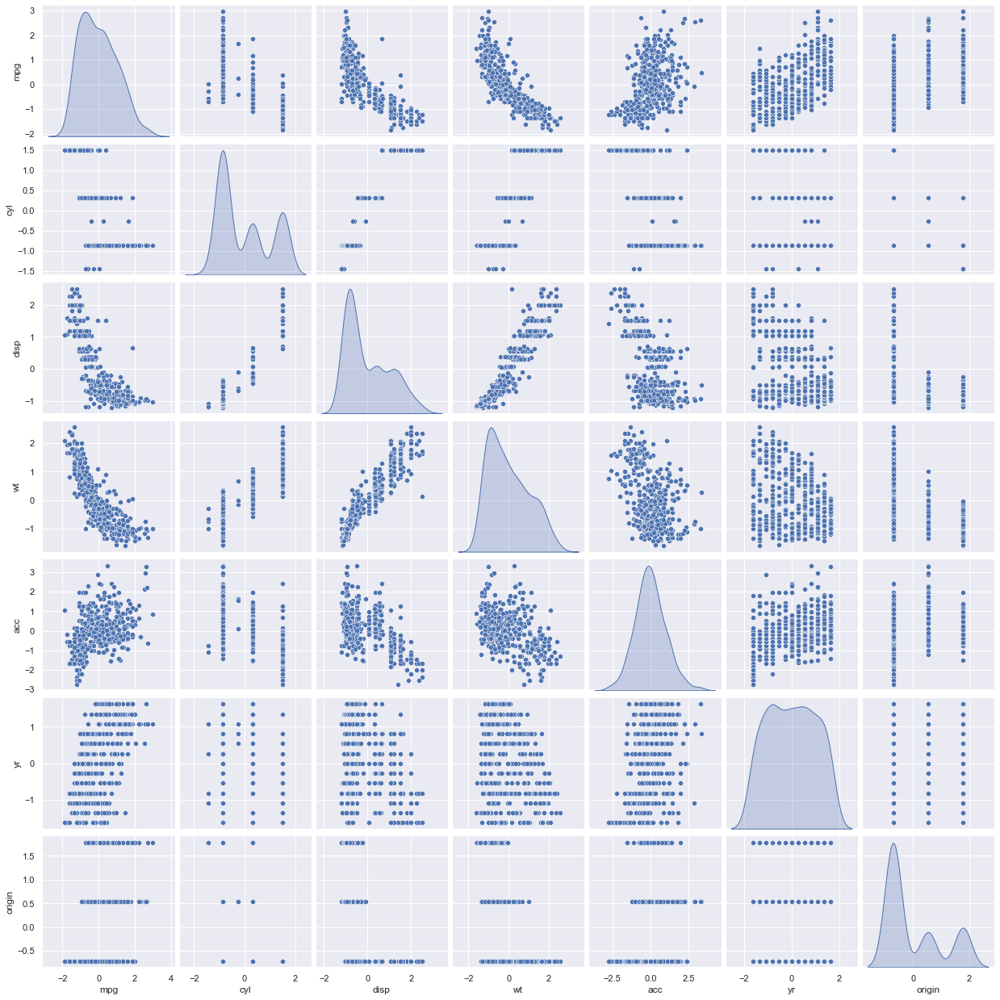

In [198]:
sns.pairplot(techSuppScaled,diag_kind='kde')

Text(0.5, 1.0, 'Selecting k with the Elbow Method')

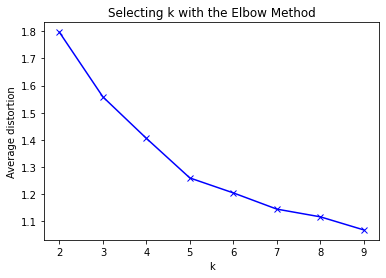

In [31]:
#Finding optimal no. of clusters

# A. Apply K-Means clustering for 2 to 10 clusters. [3 Marks]
from scipy.spatial.distance import cdist
clusters=range(2,10)
meanDistortions=[]

for k in clusters:
    model=KMeans(n_clusters=k)
    model.fit(techSuppScaled)
    prediction=model.predict(techSuppScaled)
    meanDistortions.append(sum(np.min(cdist(techSuppScaled, model.cluster_centers_, 'euclidean'), axis=1)) / techSuppScaled.shape[0])


plt.plot(clusters, meanDistortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Average distortion')
plt.title('Selecting k with the Elbow Method')

From above graph optimal nnumber of clusters are k=4 but 1st will check for k=3 and then k=5 as there are  3 blends in graph at k=3,4,5 

In [32]:
# Let us first start with K = 3
final_model=KMeans(3)
final_model.fit(techSuppScaled)
prediction=final_model.predict(techSuppScaled)

#Append the prediction 
new_Df["GROUP"] = prediction
techSuppScaled["GROUP"] = prediction
print("Groups Assigned : \n")
new_Df.head()

Groups Assigned : 



,mpg,cyl,disp,wt,acc,yr,origin,GROUP
0,18.0,8,307.0,3504,12.0,70,1,1
1,15.0,8,350.0,3693,11.5,70,1,1
2,18.0,8,318.0,3436,11.0,70,1,1
3,16.0,8,304.0,3433,12.0,70,1,1
4,17.0,8,302.0,3449,10.5,70,1,1


In [33]:
new_Df.tail()

,mpg,cyl,disp,wt,acc,yr,origin,GROUP
393,27.0,4,140.0,2790,15.6,82,1,2
394,44.0,4,97.0,2130,24.6,82,2,0
395,32.0,4,135.0,2295,11.6,82,1,0
396,28.0,4,120.0,2625,18.6,82,1,2
397,31.0,4,119.0,2720,19.4,82,1,2


# Analyze the distribution of the data among the two groups (K = 4)

In [34]:
techSuppClust = new_Df.groupby(['GROUP'])
techSuppClust.mean()

,mpg,cyl,disp,wt,acc,yr,origin
GROUP,,,,,,,
0,30.453125,4.06875,103.556250,2237.031250,16.179375,77.118750,2.356250
1,14.684848,8.00000,347.535354,4133.797980,12.714141,73.707071,1.000000
2,21.816547,5.23741,187.111511,2986.028777,16.897122,76.374101,1.079137


array([[<AxesSubplot:title={'center':'acc'}, xlabel='[GROUP]'>,
        <AxesSubplot:title={'center':'cyl'}, xlabel='[GROUP]'>,
        <AxesSubplot:title={'center':'disp'}, xlabel='[GROUP]'>,
        <AxesSubplot:title={'center':'mpg'}, xlabel='[GROUP]'>],
       [<AxesSubplot:title={'center':'origin'}, xlabel='[GROUP]'>,
        <AxesSubplot:title={'center':'wt'}, xlabel='[GROUP]'>,
        <AxesSubplot:title={'center':'yr'}, xlabel='[GROUP]'>,
        <AxesSubplot:>]], dtype=object)

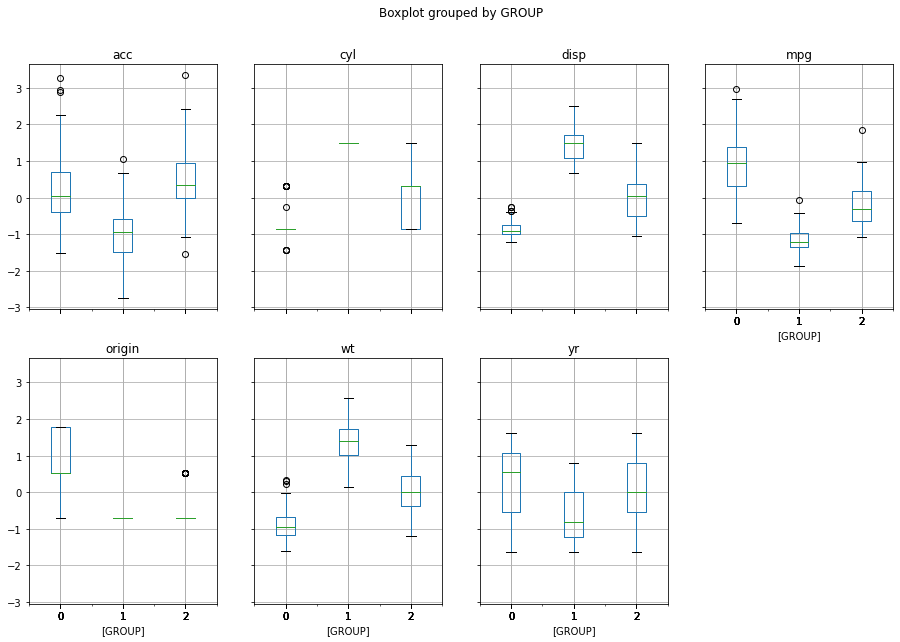

In [35]:
# Visualizing  Grouped clusters as per DataFrame

techSuppScaled.boxplot(by='GROUP', layout = (2,4),figsize=(15,10))

In [36]:
# Let us first start with K = 5
final_model=KMeans(5)
final_model.fit(techSuppScaled)
prediction=final_model.predict(techSuppScaled)

#Append the prediction 
new_Df["GROUP"] = prediction
techSuppScaled["GROUP"] = prediction
print("Groups Assigned : \n")
new_Df.head()

Groups Assigned : 



,mpg,cyl,disp,wt,acc,yr,origin,GROUP
0,18.0,8,307.0,3504,12.0,70,1,0
1,15.0,8,350.0,3693,11.5,70,1,0
2,18.0,8,318.0,3436,11.0,70,1,0
3,16.0,8,304.0,3433,12.0,70,1,0
4,17.0,8,302.0,3449,10.5,70,1,0


In [37]:
new_Df.tail()

,mpg,cyl,disp,wt,acc,yr,origin,GROUP
393,27.0,4,140.0,2790,15.6,82,1,4
394,44.0,4,97.0,2130,24.6,82,2,3
395,32.0,4,135.0,2295,11.6,82,1,3
396,28.0,4,120.0,2625,18.6,82,1,4
397,31.0,4,119.0,2720,19.4,82,1,4


In [38]:
techSuppClust1 = new_Df.groupby(['GROUP'])
techSuppClust1.mean()

,mpg,cyl,disp,wt,acc,yr,origin
GROUP,,,,,,,
0,14.552577,8.000000,348.340206,4141.659794,12.642268,73.597938,1.000000
1,26.025641,4.025641,102.487179,2261.051282,15.912821,73.961538,2.474359
2,19.132051,6.153846,231.076923,3285.820513,16.706410,75.628205,1.038462
3,34.664634,4.109756,104.573171,2214.182927,16.432927,80.121951,2.243902
4,25.117460,4.190476,136.531746,2639.190476,17.111111,77.380952,1.126984


array([[<AxesSubplot:title={'center':'acc'}, xlabel='[GROUP]'>,
        <AxesSubplot:title={'center':'cyl'}, xlabel='[GROUP]'>,
        <AxesSubplot:title={'center':'disp'}, xlabel='[GROUP]'>,
        <AxesSubplot:title={'center':'mpg'}, xlabel='[GROUP]'>],
       [<AxesSubplot:title={'center':'origin'}, xlabel='[GROUP]'>,
        <AxesSubplot:title={'center':'wt'}, xlabel='[GROUP]'>,
        <AxesSubplot:title={'center':'yr'}, xlabel='[GROUP]'>,
        <AxesSubplot:>]], dtype=object)

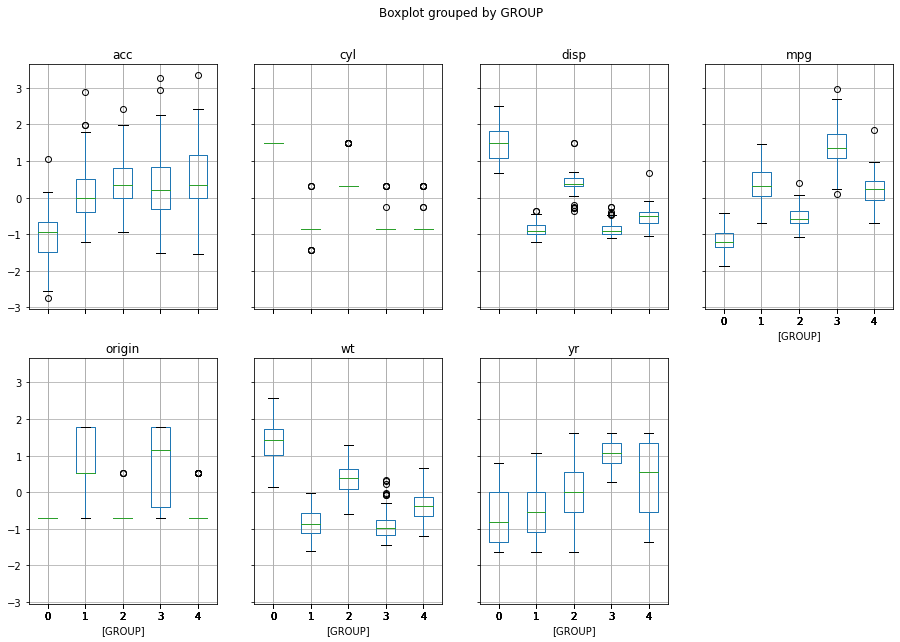

In [39]:
# Visualizing  Grouped clusters as per DataFrame

techSuppScaled.boxplot(by='GROUP', layout = (2,4),figsize=(15,10))

In [40]:
# Let us first start with K = 4
final_model=KMeans(4)
final_model.fit(techSuppScaled)
prediction=final_model.predict(techSuppScaled)

#Append the prediction 
new_Df["GROUP"] = prediction
techSuppScaled["GROUP"] = prediction
print("Groups Assigned : \n")
new_Df.head()

Groups Assigned : 



,mpg,cyl,disp,wt,acc,yr,origin,GROUP
0,18.0,8,307.0,3504,12.0,70,1,0
1,15.0,8,350.0,3693,11.5,70,1,0
2,18.0,8,318.0,3436,11.0,70,1,0
3,16.0,8,304.0,3433,12.0,70,1,0
4,17.0,8,302.0,3449,10.5,70,1,0


In [41]:
techSuppClust2 = new_Df.groupby(['GROUP'])
techSuppClust2.mean()

,mpg,cyl,disp,wt,acc,yr,origin
GROUP,,,,,,,
0,14.552577,8.000000,348.340206,4141.659794,12.642268,73.597938,1.000000
1,19.132051,6.153846,231.076923,3285.820513,16.706410,75.628205,1.038462
2,30.516552,4.144828,118.458621,2398.841379,16.727586,78.931034,1.758621
3,26.025641,4.025641,102.487179,2261.051282,15.912821,73.961538,2.474359


array([[<AxesSubplot:title={'center':'acc'}, xlabel='[GROUP]'>,
        <AxesSubplot:title={'center':'cyl'}, xlabel='[GROUP]'>,
        <AxesSubplot:title={'center':'disp'}, xlabel='[GROUP]'>,
        <AxesSubplot:title={'center':'mpg'}, xlabel='[GROUP]'>],
       [<AxesSubplot:title={'center':'origin'}, xlabel='[GROUP]'>,
        <AxesSubplot:title={'center':'wt'}, xlabel='[GROUP]'>,
        <AxesSubplot:title={'center':'yr'}, xlabel='[GROUP]'>,
        <AxesSubplot:>]], dtype=object)

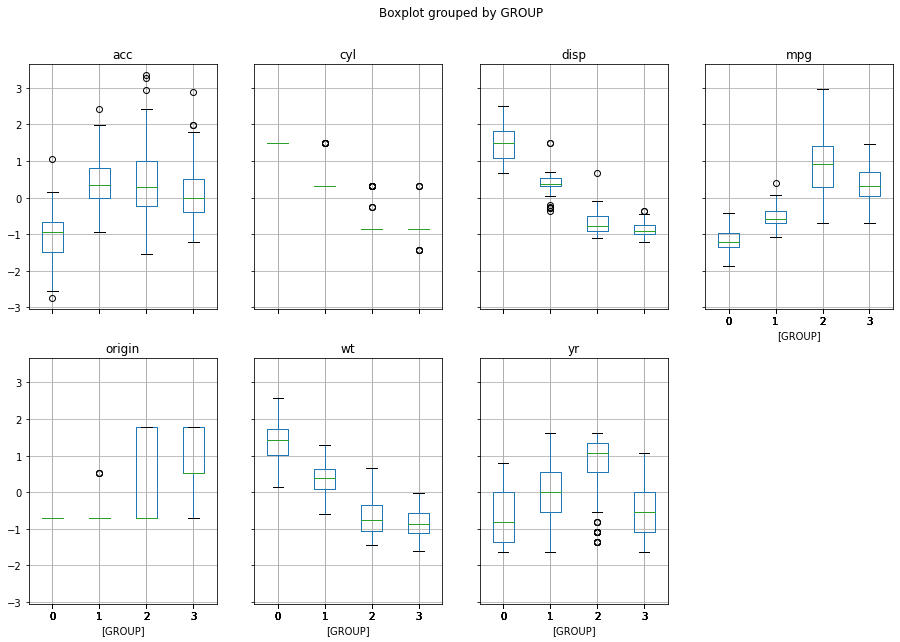

In [42]:
# Visualizing  Grouped clusters as per DataFrame
techSuppScaled.boxplot(by='GROUP', layout = (2,4),figsize=(15,10))

From above all obseravtions K=4 is optimal number of oberservations of cluster

Text(0.5, 1.0, 'Selecting k with the Elbow Method')

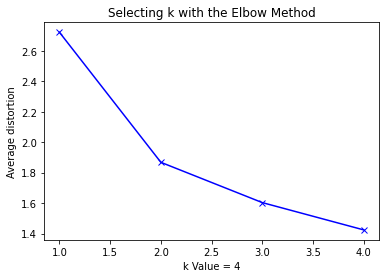

In [43]:
# D. Train a K-means clustering model once again on the optimal number of clusters. [3 Marks]

from scipy.spatial.distance import cdist
clusters=range(1,5)
meanDistortions=[]

for k in clusters:
    model=KMeans(n_clusters=k)
    model.fit(techSuppScaled)
    prediction=model.predict(techSuppScaled)
    meanDistortions.append(sum(np.min(cdist(techSuppScaled, model.cluster_centers_, 'euclidean'), axis=1)) / techSuppScaled.shape[0])


plt.plot(clusters, meanDistortions, 'bx-')
plt.xlabel('k Value = 4')
plt.ylabel('Average distortion')
plt.title('Selecting k with the Elbow Method')

2    145
0     97
1     78
3     78
Name: GROUP, dtype: int64


<AxesSubplot:title={'center':'Count of Cluster'}, xlabel='GROUP', ylabel='count'>

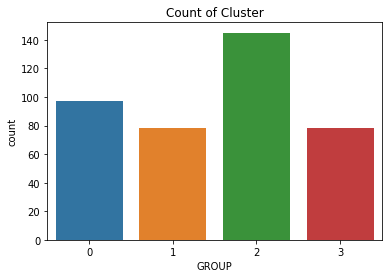

In [44]:
# E. Add a new feature in the DataFrame which will have labels based upon cluster value. [2 Marks]
#  replacing value of GRoup based on Cluser
AddFeature = new_Df
AddFeature.head()

print(AddFeature['GROUP'].value_counts())
plt.title('Count of Cluster')
sns.countplot(x = 'GROUP', data = AddFeature)

In [45]:
AddFeature["GROUP"] = AddFeature["GROUP"].replace({0: 'First', 1: 'Second', 2: 'Third', 3:'Fourth'})
AddFeature.head()

,mpg,cyl,disp,wt,acc,yr,origin,GROUP
0,18.0,8,307.0,3504,12.0,70,1,First
1,15.0,8,350.0,3693,11.5,70,1,First
2,18.0,8,318.0,3436,11.0,70,1,First
3,16.0,8,304.0,3433,12.0,70,1,First
4,17.0,8,302.0,3449,10.5,70,1,First


In [46]:
AddFeature.tail()

,mpg,cyl,disp,wt,acc,yr,origin,GROUP
393,27.0,4,140.0,2790,15.6,82,1,Third
394,44.0,4,97.0,2130,24.6,82,2,Third
395,32.0,4,135.0,2295,11.6,82,1,Third
396,28.0,4,120.0,2625,18.6,82,1,Third
397,31.0,4,119.0,2720,19.4,82,1,Third


In [47]:
# One Hot encoding
df = new_Df
X= df.drop("GROUP",axis=True)
y= df["GROUP"]
new_group = pd.get_dummies(y, columns=["GROUP"])

new_group.columns =['First', 'Second', 'Third', 'Fourth']

new_group.head()

,First,Second,Third,Fourth
0,1,0,0,0
1,1,0,0,0
2,1,0,0,0
3,1,0,0,0
4,1,0,0,0


In [48]:
from sklearn.cluster import KMeans


kmeans = KMeans(n_clusters=4, random_state=0)

new_group["cluster"] = kmeans.fit_predict(new_group)

# get centroids
centroids = kmeans.cluster_centers_
cen_x = [i[0] for i in centroids] 
cen_y = [i[1] for i in centroids]
## add to df
new_group['cen_x'] = new_group.cluster.map({0:cen_x[0], 1:cen_x[1], 2:cen_x[2], 3:cen_x[3]})
new_group['cen_y'] = new_group.cluster.map({0:cen_y[0], 1:cen_y[1], 2:cen_y[2],3:cen_y[3]})
# define and map colors
colors = ['#DF2020', '#81DF20', '#2095DF','#f9f8fa']
new_group['c'] = new_group.cluster.map({0:colors[0], 1:colors[1], 2:colors[2],3:colors[3]})

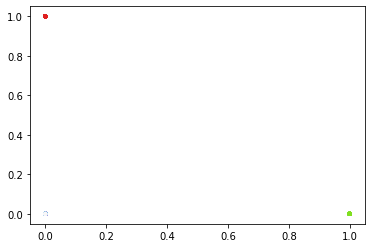

In [49]:
import matplotlib.pyplot as plt
plt.scatter(new_group["Fourth"],new_group["Second"],c=new_group.c, alpha = 0.6, s=10)

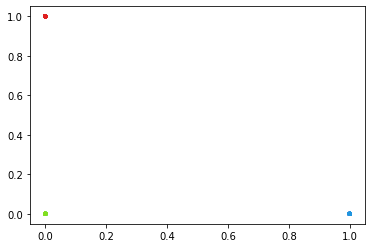

In [50]:
plt.scatter(new_group["First"],new_group["Second"],c=new_group.c, alpha = 0.6, s=10)

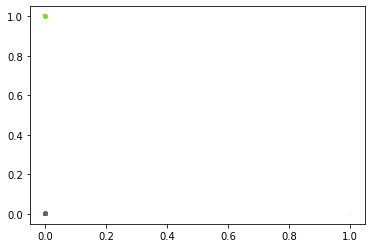

In [51]:
plt.scatter(new_group["Third"],new_group["Fourth"],c=new_group.c, alpha = 0.6, s=10)

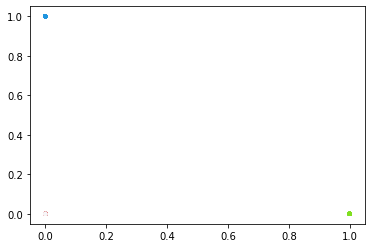

In [52]:
plt.scatter(new_group["Fourth"],new_group["First"],c=new_group.c, alpha = 0.6, s=10)

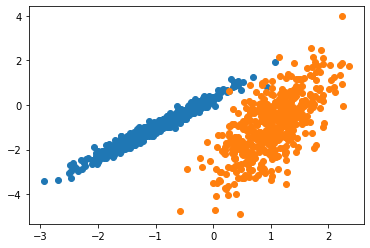

In [53]:
# G. Pass a new DataPoint and predict which cluster it belongs to. [2 Marks]

# synthetic classification dataset
from numpy import where
from sklearn.datasets import make_classification
from matplotlib import pyplot
# define dataset
X, y = make_classification(n_samples=1000, n_features=2, n_informative=2, n_redundant=0, n_clusters_per_class=1, random_state=4)
# create scatter plot for samples from each class
for class_value in range(2):
	# get row indexes for samples with this class
	row_ix = where(y == class_value)
	# create scatter of these samples
	pyplot.scatter(X[row_ix, 0], X[row_ix, 1])
# show the plot
pyplot.show()


In [54]:
def fun(x,y) :
    clusters=range(1,5)
    meanDistortions=[]

    for k in clusters:
        model=KMeans(n_clusters=k)
        model.fit(techSuppScaled)
        prediction=model.predict(techSuppScaled)
        meanDistortions.append(sum(np.min(cdist(techSuppScaled, model.cluster_centers_, 'euclidean'), axis=1)) / techSuppScaled.shape[0])

    plt.plot(clusters, meanDistortions, 'bx-')
    
    plt.xlabel('X Value')
    plt.ylabel('Y Value')
    plt.title('Finding Cluster with given Datapoints')
    
    plt.plot(x, y, 'o', color='red');
    
    return x

Value of Cluster Number to which your points belong : 
2


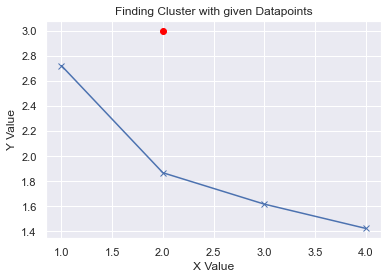

In [103]:
k_Value = fun(2,3)

print("Value of Cluster Number to which your points belong : ")
print(k_Value)

PART B

# Question 1. Data Understanding & Cleaning: [5 Marks]
#  A. Read ‘vehicle.csv’ and save as DataFrame. [1 Marks]
#  B. Check percentage of missing values and impute with correct approach. [1 Marks]
#  C. Visualize a Pie-chart and print percentage of values for variable ‘class’. [2 Marks]
#  D. Check for duplicate rows in the data and impute with correct approach. [1 Marks]

In [56]:
# A. Read ‘vehicle.csv’ and save as DataFrame. [1 Marks]

vehicle = pd.read_csv('vehicle.csv')
vehicle.shape

(846, 19)

In [57]:
vehicle.info()
vehicle.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 846 entries, 0 to 845
Data columns (total 19 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   compactness                  846 non-null    int64  
 1   circularity                  841 non-null    float64
 2   distance_circularity         842 non-null    float64
 3   radius_ratio                 840 non-null    float64
 4   pr.axis_aspect_ratio         844 non-null    float64
 5   max.length_aspect_ratio      846 non-null    int64  
 6   scatter_ratio                845 non-null    float64
 7   elongatedness                845 non-null    float64
 8   pr.axis_rectangularity       843 non-null    float64
 9   max.length_rectangularity    846 non-null    int64  
 10  scaled_variance              843 non-null    float64
 11  scaled_variance.1            844 non-null    float64
 12  scaled_radius_of_gyration    844 non-null    float64
 13  scaled_radius_of_gyr

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
0,95,48.0,83.0,178.0,72.0,10,162.0,42.0,20.0,159,176.0,379.0,184.0,70.0,6.0,16.0,187.0,197,van
1,91,41.0,84.0,141.0,57.0,9,149.0,45.0,19.0,143,170.0,330.0,158.0,72.0,9.0,14.0,189.0,199,van
2,104,50.0,106.0,209.0,66.0,10,207.0,32.0,23.0,158,223.0,635.0,220.0,73.0,14.0,9.0,188.0,196,car
3,93,41.0,82.0,159.0,63.0,9,144.0,46.0,19.0,143,160.0,309.0,127.0,63.0,6.0,10.0,199.0,207,van
4,85,44.0,70.0,205.0,103.0,52,149.0,45.0,19.0,144,241.0,325.0,188.0,127.0,9.0,11.0,180.0,183,bus


In [58]:
vehicle.describe()

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio
count,846.000000,841.000000,842.000000,840.000000,844.000000,846.000000,845.000000,845.000000,843.000000,846.000000,843.000000,844.000000,844.000000,842.000000,840.000000,845.000000,845.000000,846.000000
mean,93.678487,44.828775,82.110451,168.888095,61.678910,8.567376,168.901775,40.933728,20.582444,147.998818,188.631079,439.494076,174.709716,72.447743,6.364286,12.602367,188.919527,195.632388
std,8.234474,6.152172,15.778292,33.520198,7.891463,4.601217,33.214848,7.816186,2.592933,14.515652,31.411004,176.666903,32.584808,7.486190,4.920649,8.936081,6.155809,7.438797
min,73.000000,33.000000,40.000000,104.000000,47.000000,2.000000,112.000000,26.000000,17.000000,118.000000,130.000000,184.000000,109.000000,59.000000,0.000000,0.000000,176.000000,181.000000
25%,87.000000,40.000000,70.000000,141.000000,57.000000,7.000000,147.000000,33.000000,19.000000,137.000000,167.000000,318.000000,149.000000,67.000000,2.000000,5.000000,184.000000,190.250000
50%,93.000000,44.000000,80.000000,167.000000,61.000000,8.000000,157.000000,43.000000,20.000000,146.000000,179.000000,363.500000,173.500000,71.500000,6.000000,11.000000,188.000000,197.000000
75%,100.000000,49.000000,98.000000,195.000000,65.000000,10.000000,198.000000,46.000000,23.000000,159.000000,217.000000,587.000000,198.000000,75.000000,9.000000,19.000000,193.000000,201.000000
max,119.000000,59.000000,112.000000,333.000000,138.000000,55.000000,265.000000,61.000000,29.000000,188.000000,320.000000,1018.000000,268.000000,135.000000,22.000000,41.000000,206.000000,211.000000


In [59]:
vehicle.describe().T

,count,mean,std,min,25%,50%,75%,max
compactness,846.0,93.678487,8.234474,73.0,87.00,93.0,100.0,119.0
circularity,841.0,44.828775,6.152172,33.0,40.00,44.0,49.0,59.0
distance_circularity,842.0,82.110451,15.778292,40.0,70.00,80.0,98.0,112.0
radius_ratio,840.0,168.888095,33.520198,104.0,141.00,167.0,195.0,333.0
pr.axis_aspect_ratio,844.0,61.678910,7.891463,47.0,57.00,61.0,65.0,138.0
max.length_aspect_ratio,846.0,8.567376,4.601217,2.0,7.00,8.0,10.0,55.0
scatter_ratio,845.0,168.901775,33.214848,112.0,147.00,157.0,198.0,265.0
elongatedness,845.0,40.933728,7.816186,26.0,33.00,43.0,46.0,61.0
pr.axis_rectangularity,843.0,20.582444,2.592933,17.0,19.00,20.0,23.0,29.0
max.length_rectangularity,846.0,147.998818,14.515652,118.0,137.00,146.0,159.0,188.0


In [60]:
# check for null value in each column 

vehicle.isnull().sum()

compactness                    0
circularity                    5
distance_circularity           4
radius_ratio                   6
pr.axis_aspect_ratio           2
max.length_aspect_ratio        0
scatter_ratio                  1
elongatedness                  1
pr.axis_rectangularity         3
max.length_rectangularity      0
scaled_variance                3
scaled_variance.1              2
scaled_radius_of_gyration      2
scaled_radius_of_gyration.1    4
skewness_about                 6
skewness_about.1               1
skewness_about.2               1
hollows_ratio                  0
class                          0
dtype: int64

In [61]:
# B. Check percentage of missing values and impute with correct approach. [1 Marks]

percent_missing = vehicle.isnull().sum() * 100 / len(vehicle)

percent_missing

compactness                    0.000000
circularity                    0.591017
distance_circularity           0.472813
radius_ratio                   0.709220
pr.axis_aspect_ratio           0.236407
max.length_aspect_ratio        0.000000
scatter_ratio                  0.118203
elongatedness                  0.118203
pr.axis_rectangularity         0.354610
max.length_rectangularity      0.000000
scaled_variance                0.354610
scaled_variance.1              0.236407
scaled_radius_of_gyration      0.236407
scaled_radius_of_gyration.1    0.472813
skewness_about                 0.709220
skewness_about.1               0.118203
skewness_about.2               0.118203
hollows_ratio                  0.000000
class                          0.000000
dtype: float64

In [62]:
# Original dataframe size
Original_size = vehicle.size

# drop dataframe
vehicle.dropna(inplace=True)

# New dataframe size
New_size=vehicle.size

print("> Original:",Original_size,"vs","New:",New_size)

# Data drop impact analysis

Data_lost=100*((Original_size-New_size)/Original_size)
print("> Percentage of data lost",Data_lost,"%")
if Data_lost<=5:
    print("\n> Not much data has been lost,dropping data was a good option")
else:
    print("\n> Considerable data has been lost,dropping data was not a good option. We need to impute data")

> Original: 16074 vs New: 15447
> Percentage of data lost 3.900709219858156 %

> Not much data has been lost,dropping data was a good option


But as per our Question we have to imput with correct approach so we are filling missing value with mean.

In [63]:
vehicle = vehicle.fillna(vehicle.mean())
vehicle.isnull().sum() 

compactness                    0
circularity                    0
distance_circularity           0
radius_ratio                   0
pr.axis_aspect_ratio           0
max.length_aspect_ratio        0
scatter_ratio                  0
elongatedness                  0
pr.axis_rectangularity         0
max.length_rectangularity      0
scaled_variance                0
scaled_variance.1              0
scaled_radius_of_gyration      0
scaled_radius_of_gyration.1    0
skewness_about                 0
skewness_about.1               0
skewness_about.2               0
hollows_ratio                  0
class                          0
dtype: int64

Now all missing values are filled with mean

In [64]:
# C. Visualize a Pie-chart and print percentage of values for variable ‘class’. [2 Marks]

vehiclePie = vehicle.select_dtypes(include=['object']).copy()
vehiclePie.head()

,class
0,van
1,van
2,car
3,van
4,bus


In [65]:
print(vehiclePie.isnull().values.sum())
print(vehiclePie['class'].value_counts().count())

0
3


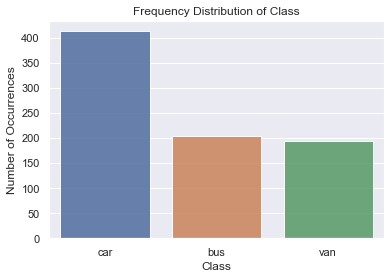

In [66]:
class_count = vehiclePie['class'].value_counts()
sns.set(style="darkgrid")
sns.barplot(class_count.index, class_count.values, alpha=0.9)
plt.title('Frequency Distribution of Class')
plt.ylabel('Number of Occurrences', fontsize=12)
plt.xlabel('Class', fontsize=12)
plt.show()

In [67]:
def pieDraw(df):
    labels = df.astype('category').cat.categories.tolist()
    counts = df.value_counts()
    sizes = [counts[var_cat] for var_cat in labels]
    fig1, ax1 = plt.subplots()
    ax1.pie(sizes, labels=labels, autopct='%1.1f%%', shadow=True) #autopct is to show the % on plot
    ax1.axis('equal')
    plt.show()

Frequency Distribution of Class


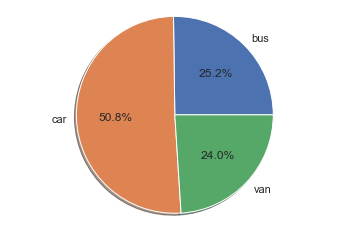

In [68]:
print('Frequency Distribution of Class')

pieDraw(vehiclePie['class'])

In [69]:
# D. Check for duplicate rows in the data and impute with correct approach. [1 Marks]


# Selecting duplicate rows except first 
# occurrence based on all columns
duplicate = vehicle[vehicle.duplicated()]
duplicate.shape

(0, 19)

In [70]:
print("Duplicate Rows :")
duplicate

Duplicate Rows :


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class


From above result there are no duplicate records in dataframe vehicle.

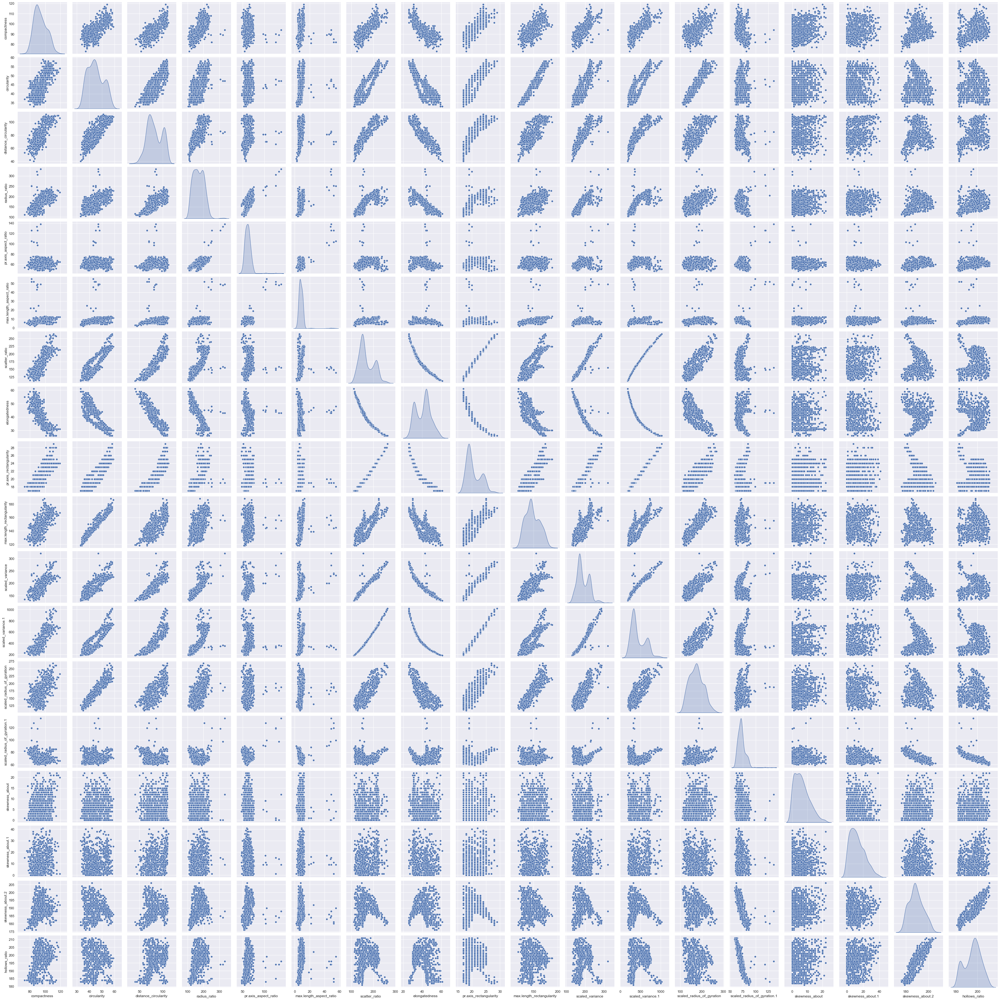

In [65]:
from scipy.stats import zscore

sns.pairplot(vehicle, diag_kind="kde")

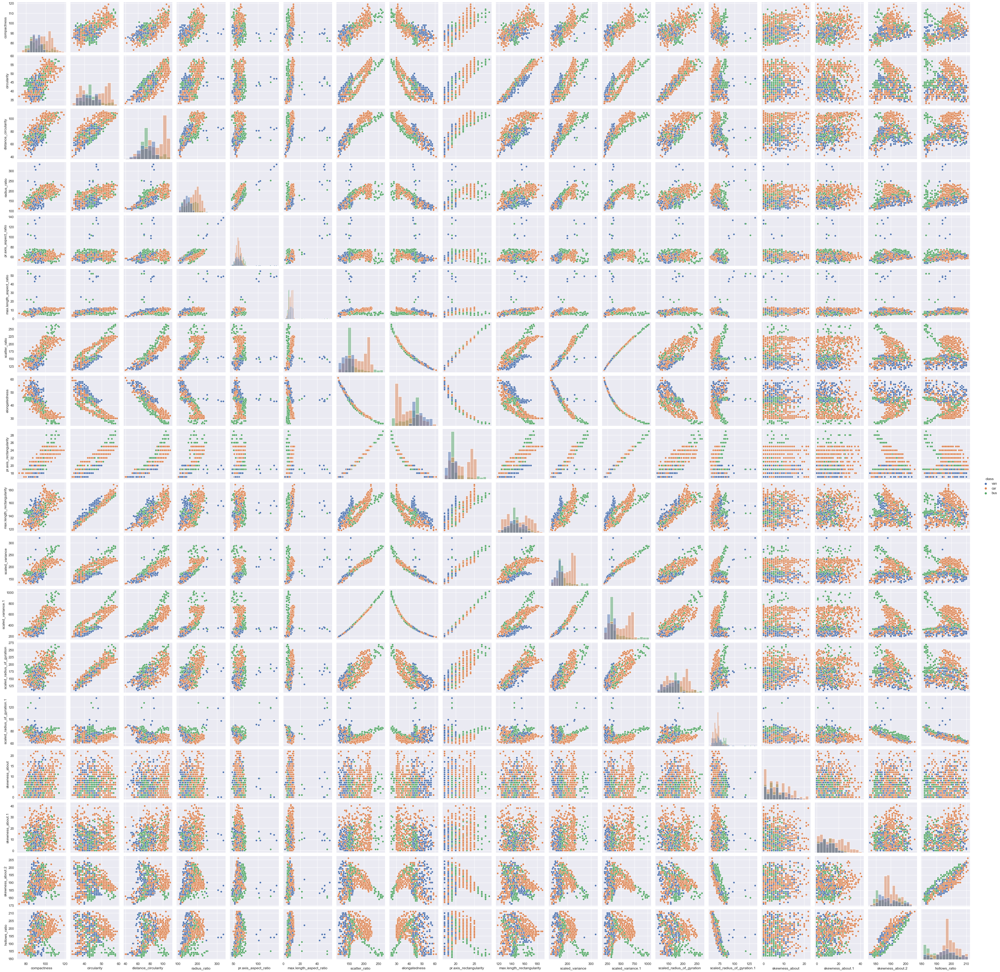

In [66]:
sns.pairplot(vehicle,hue="class", diag_kind="hist")

# Question 2. Data Preparation: [2 Marks]
#    A. Split data into X and Y. [Train and Test optional] [1 Marks]
#    B. Standardize the Data. [1 Marks]


In [71]:
# label_encoder object knows how to understand word labels.

from sklearn import preprocessing

label_encoder = preprocessing.LabelEncoder()
 
# Encode labels in column 'species'.
vehicle['class']= label_encoder.fit_transform(vehicle['class'])
 
vehicle['class'].unique()

array([2, 1, 0])

In [72]:
vehicle.head()

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio,class
0,95,48.0,83.0,178.0,72.0,10,162.0,42.0,20.0,159,176.0,379.0,184.0,70.0,6.0,16.0,187.0,197,2
1,91,41.0,84.0,141.0,57.0,9,149.0,45.0,19.0,143,170.0,330.0,158.0,72.0,9.0,14.0,189.0,199,2
2,104,50.0,106.0,209.0,66.0,10,207.0,32.0,23.0,158,223.0,635.0,220.0,73.0,14.0,9.0,188.0,196,1
3,93,41.0,82.0,159.0,63.0,9,144.0,46.0,19.0,143,160.0,309.0,127.0,63.0,6.0,10.0,199.0,207,2
4,85,44.0,70.0,205.0,103.0,52,149.0,45.0,19.0,144,241.0,325.0,188.0,127.0,9.0,11.0,180.0,183,0


In [73]:
#  A. Split data into X and Y. [Train and Test optional] [1 Marks]
#  separating  the independent and dependent variables
X = vehicle.drop(labels= "class" , axis = 1)
y = vehicle["class"]
X.head()

,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio
0,95,48.0,83.0,178.0,72.0,10,162.0,42.0,20.0,159,176.0,379.0,184.0,70.0,6.0,16.0,187.0,197
1,91,41.0,84.0,141.0,57.0,9,149.0,45.0,19.0,143,170.0,330.0,158.0,72.0,9.0,14.0,189.0,199
2,104,50.0,106.0,209.0,66.0,10,207.0,32.0,23.0,158,223.0,635.0,220.0,73.0,14.0,9.0,188.0,196
3,93,41.0,82.0,159.0,63.0,9,144.0,46.0,19.0,143,160.0,309.0,127.0,63.0,6.0,10.0,199.0,207
4,85,44.0,70.0,205.0,103.0,52,149.0,45.0,19.0,144,241.0,325.0,188.0,127.0,9.0,11.0,180.0,183


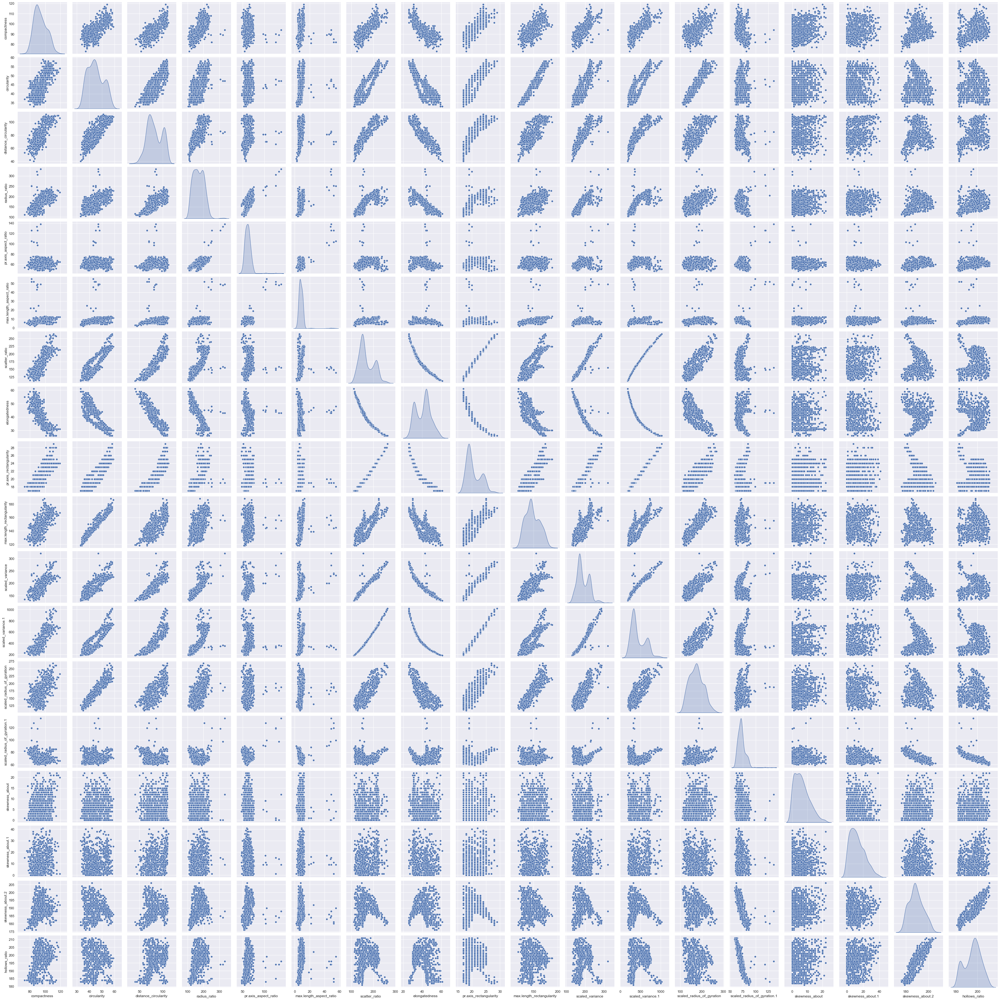

In [71]:
sns.pairplot(X, diag_kind='kde') 

In [74]:
# #  B. Standardize the Data. [1 Marks]

from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
# fit and transform the data
scaled_data = scaler.fit_transform(X)
print(X)
print(scaled_data)

     compactness  circularity  distance_circularity  radius_ratio  \
0             95         48.0                  83.0         178.0   
1             91         41.0                  84.0         141.0   
2            104         50.0                 106.0         209.0   
3             93         41.0                  82.0         159.0   
4             85         44.0                  70.0         205.0   
..           ...          ...                   ...           ...   
841           93         39.0                  87.0         183.0   
842           89         46.0                  84.0         163.0   
843          106         54.0                 101.0         222.0   
844           86         36.0                  78.0         146.0   
845           85         36.0                  66.0         123.0   

     pr.axis_aspect_ratio  max.length_aspect_ratio  scatter_ratio  \
0                    72.0                       10          162.0   
1                    57.0        

# Question 3. Model Building: [13 Marks]
#  A. Train a base Classification model using SVM. [1 Marks]
#  B. Print Classification metrics for train data. [1 Marks]
#  C. Apply PCA on the data with 10 components. [3 Marks]
#  D. Visualize Cumulative Variance Explained with Number of Components. [2 Marks]
#  E. Draw a horizontal line on the above plot to highlight the threshold of 90%. [1 Marks]
#  F. Apply PCA on the data. This time Select Minimum Components with 90% or above variance explained. [2 Marks]
#  G. Train SVM model on components selected from above step. [1 Marks]
#  H. Print Classification metrics for train data of above model and share insights. [2 Marks]

In [75]:
# A. Train a base Classification model using SVM. [1 Marks]

from sklearn import svm
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score
from sklearn import metrics
import seaborn as sns

As it is mentioned in the question that spliting of train and test is optional so firstly will calculate accuracy without spliting train and test then secondly will calculate with split.

# i) Without spliting train and test data will calculate accuracy and classification report

In [76]:
clf = svm.SVC(gamma=0.025, C=3)  
clf
clf.fit(X, y)
y_pred = clf.predict(X)

In [77]:
# B. Print Classification metrics for train data. [1 Marks] 

print(classification_report(y, y_pred))


              precision    recall  f1-score   support

           0       1.00      1.00      1.00       205
           1       1.00      1.00      1.00       413
           2       1.00      1.00      1.00       195

    accuracy                           1.00       813
   macro avg       1.00      1.00      1.00       813
weighted avg       1.00      1.00      1.00       813



In [78]:
print(accuracy_score(y, y_pred))


1.0


In [79]:
print(metrics.confusion_matrix(y, y_pred))

[[205   0   0]
 [  0 413   0]
 [  0   0 195]]


# ii) With spliting train and test data will calculate accuracy and classification report 

In [80]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=1)
clf1 = svm.SVC(gamma=0.025, C=3)  
clf1
clf1.fit(X_train, y_train)
y_pred1 = clf.predict(X_test)

In [81]:
print(classification_report(y_test, y_pred1))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        36
           1       1.00      1.00      1.00        95
           2       1.00      1.00      1.00        32

    accuracy                           1.00       163
   macro avg       1.00      1.00      1.00       163
weighted avg       1.00      1.00      1.00       163



In [82]:
print(accuracy_score(y_test, y_pred1))


1.0


In [83]:
print(confusion_matrix(y_test,y_pred1))

[[36  0  0]
 [ 0 95  0]
 [ 0  0 32]]


From above result without splitting data to train and test we are getting accuracy of 100% but with splitting data to train and test we are getting accuracy to 60%.From above result we can coclude that with spliting data accuracy decreases.

In [84]:
# C. Apply PCA on the data with 10 components. [3 Marks]


from scipy.stats import zscore
XScaled=X.apply(zscore)
XScaled.head()


,compactness,circularity,distance_circularity,radius_ratio,pr.axis_aspect_ratio,max.length_aspect_ratio,scatter_ratio,elongatedness,pr.axis_rectangularity,max.length_rectangularity,scaled_variance,scaled_variance.1,scaled_radius_of_gyration,scaled_radius_of_gyration.1,skewness_about,skewness_about.1,skewness_about.2,hollows_ratio
0,0.163231,0.520408,0.060669,0.264970,1.283254,0.299721,-0.198517,0.129648,-0.217151,0.766312,-0.397397,-0.339014,0.301676,-0.321192,-0.071523,0.371287,-0.321809,0.171837
1,-0.322874,-0.619123,0.124067,-0.836393,-0.599253,0.085785,-0.591720,0.514333,-0.606014,-0.337462,-0.590034,-0.618754,-0.502972,-0.053505,0.538425,0.147109,0.003400,0.442318
2,1.256966,0.845988,1.518823,1.187734,0.530251,0.299721,1.162569,-1.152637,0.949438,0.697326,1.111591,1.122486,1.415804,0.080339,1.555006,-0.413338,-0.159204,0.036596
3,-0.079822,-0.619123,-0.002729,-0.300595,0.153750,0.085785,-0.742952,0.642562,-0.606014,-0.337462,-0.911095,-0.738643,-1.462359,-1.258099,-0.071523,-0.301249,1.629444,1.524243
4,-1.052030,-0.130753,-0.763506,1.068668,5.173770,9.285029,-0.591720,0.514333,-0.606014,-0.268476,1.689501,-0.647299,0.425468,7.307905,0.538425,-0.189159,-1.460039,-1.721531


In [85]:
covMatrix = np.cov(XScaled,rowvar=False)
print(covMatrix)

[[ 1.00123153  0.69073497  0.79092746  0.68897729  0.09066804  0.1505537
   0.81502868 -0.78902127  0.81522961  0.67573322  0.76532752  0.82125027
   0.58212123 -0.25875528  0.23193313  0.16859183  0.29656022  0.3732647 ]
 [ 0.69073497  1.00123153  0.79868656  0.62471862  0.15521415  0.25192897
   0.85920548 -0.8261242   0.85719089  0.96655501  0.80710097  0.85197956
   0.93674669  0.0491303   0.1419004  -0.00197723 -0.1140426   0.04939203]
 [ 0.79092746  0.79868656  1.00123153  0.77235395  0.16358689  0.26591783
   0.91014241 -0.9138366   0.89836576  0.77441118  0.86674929  0.89288735
   0.70655787 -0.23843852  0.11041593  0.278193    0.14543699  0.34365085]
 [ 0.68897729  0.62471862  0.77235395  1.00123153  0.66819724  0.45301698
   0.74438595 -0.79674104  0.71709175  0.57118076  0.80778118  0.73267385
   0.54530637 -0.17556405  0.04474816  0.17829807  0.37605357  0.47147529]
 [ 0.09066804  0.15521415  0.16358689  0.66819724  1.00123153  0.6528959
   0.11383635 -0.19142882  0.0870987

PCA Expalained Variance:
[9.453387   2.98961888 1.91768721 1.17011696 0.92909452 0.5321711
 0.35907377 0.22236083 0.15609314 0.09281912]
PCA Components:
[[ 2.74447428e-01  2.94003600e-01  3.04380218e-01  2.68888600e-01
   8.30199914e-02  9.84825471e-02  3.16688948e-01 -3.13205048e-01
   3.13612229e-01  2.81285672e-01  3.09161565e-01  3.14163506e-01
   2.70337322e-01 -2.56036923e-02  3.96799548e-02  6.31600075e-02
   3.09410342e-02  7.93661290e-02]
 [-1.27105989e-01  1.34430321e-01 -7.21448351e-02 -1.76416250e-01
  -9.87633531e-02  3.02068515e-02  4.43899402e-02  1.52539710e-02
   5.72306050e-02  1.20324381e-01  6.19096771e-02  4.80210991e-02
   2.10169704e-01  4.93793797e-01 -5.62601909e-02 -1.21035426e-01
  -5.44491703e-01 -5.38881650e-01]
 [-1.15778231e-01 -3.64513515e-02 -5.51881577e-02  2.81804540e-01
   6.45768877e-01  5.86412351e-01 -9.85848213e-02  5.66515157e-02
  -1.12039253e-01 -2.41324720e-02  5.97234736e-02 -1.09452782e-01
  -3.70630986e-02  2.75779539e-01 -1.10191782e-01 -

Text(0.5, 0, 'Principal Components')

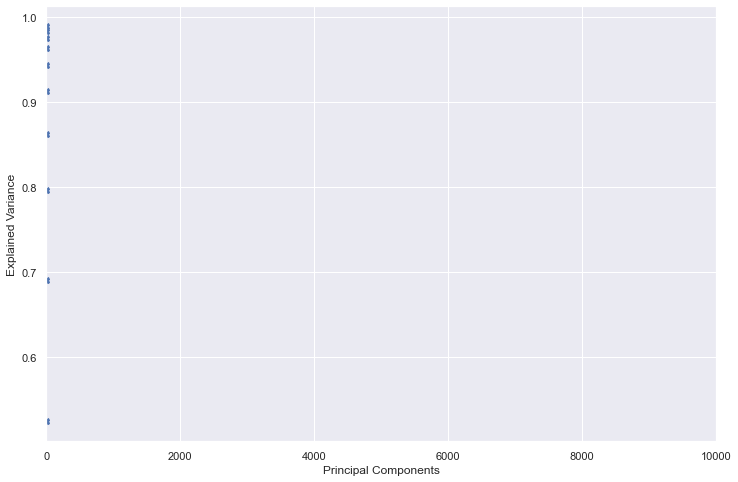

In [88]:
from sklearn.decomposition import PCA

pca = PCA(n_components=10)
pca.fit(XScaled)

print("PCA Expalained Variance:")
print(pca.explained_variance_)

print("PCA Components:")
print(pca.components_)

print("PCA Expalained Variance Ratio:")
print(pca.explained_variance_ratio_)


plt.figure(figsize = (12, 8))
plt.plot( pca.explained_variance_ratio_, np.cumsum(pca.explained_variance_ratio_), marker = 'X')
plt.xlim(0, 10000)
plt.ylabel('Explained Variance')
plt.xlabel('Principal Components')

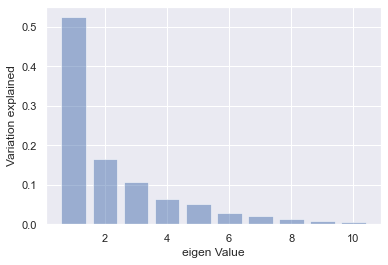

In [89]:
# D. Visualize Cumulative Variance Explained with Number of Components. [2 Marks]
plt.bar(list(range(1,11)),pca.explained_variance_ratio_,alpha=0.5, align='center')
plt.ylabel('Variation explained')
plt.xlabel('eigen Value')
plt.show()

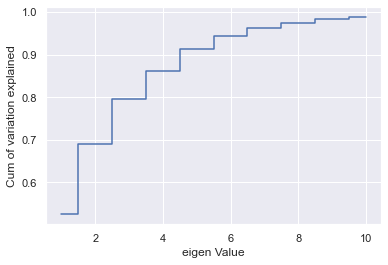

In [90]:
# Graph without threshold
plt.step(list(range(1,11)),np.cumsum(pca.explained_variance_ratio_), where='mid')
plt.ylabel('Cum of variation explained')
plt.xlabel('eigen Value')
plt.show()

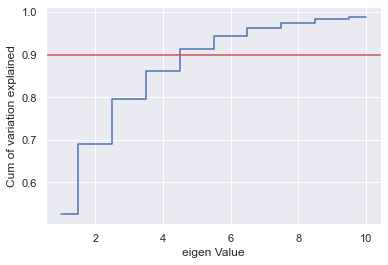

In [91]:
# E. Draw a horizontal line on the above plot to highlight the threshold of 90%. [1 Marks]
# Now applying threshold of 90% 

fig, ax = plt.subplots()

plt.step(list(range(1,11)),np.cumsum(pca.explained_variance_ratio_), where='mid')
plt.ylabel('Cum of variation explained')
plt.xlabel('eigen Value')
ax.axhline(y=0.9, xmin=0.0, xmax=1.0, color='r')
plt.show()

In [92]:
# F. Apply PCA on the data. This time Select Minimum Components with 90% or above variance explained. [2 Marks]
#  minimum of 90%
# Dimensionality Reduction

pca3 = PCA(n_components=9)
pca3.fit(XScaled)

print(pca3.components_)
print(pca3.explained_variance_ratio_)
Xpca3 = pca3.transform(XScaled)

[[ 2.74447428e-01  2.94003600e-01  3.04380218e-01  2.68888600e-01
   8.30199914e-02  9.84825471e-02  3.16688948e-01 -3.13205048e-01
   3.13612229e-01  2.81285672e-01  3.09161565e-01  3.14163506e-01
   2.70337322e-01 -2.56036923e-02  3.96799548e-02  6.31600075e-02
   3.09410342e-02  7.93661290e-02]
 [-1.27105989e-01  1.34430321e-01 -7.21448351e-02 -1.76416250e-01
  -9.87633531e-02  3.02068515e-02  4.43899402e-02  1.52539710e-02
   5.72306050e-02  1.20324381e-01  6.19096771e-02  4.80210991e-02
   2.10169704e-01  4.93793797e-01 -5.62601909e-02 -1.21035426e-01
  -5.44491703e-01 -5.38881650e-01]
 [-1.15778231e-01 -3.64513515e-02 -5.51881577e-02  2.81804540e-01
   6.45768877e-01  5.86412351e-01 -9.85848213e-02  5.66515157e-02
  -1.12039253e-01 -2.41324720e-02  5.97234736e-02 -1.09452782e-01
  -3.70630986e-02  2.75779539e-01 -1.10191782e-01 -8.04993535e-02
   3.17280047e-02  5.69462532e-02]
 [ 8.00766389e-02  1.90342131e-01 -6.93709791e-02 -4.46505645e-02
   3.00532206e-02  2.97502955e-02 -9.

In [93]:
Xpca3

array([[ 0.35224921, -0.14102681,  0.96183193, ..., -0.8820798 ,
        -0.38832347, -0.9081888 ],
       [-1.5780723 , -0.4221973 , -0.36526142, ...,  0.34563917,
         0.25832407,  0.13788287],
       [ 3.78255625,  0.25325744,  0.06175618, ..., -0.0159406 ,
         0.4788957 , -0.27596753],
       ...,
       [ 4.83112974,  0.07323619,  0.48997353, ...,  0.59951984,
         0.12766991, -0.61546869],
       [-3.26941568, -1.01866536, -0.34344083, ..., -0.24114332,
         0.31487696, -0.22022929],
       [-4.75521696,  0.30767001, -0.58216391, ...,  0.05533584,
        -0.23686544, -0.45108813]])

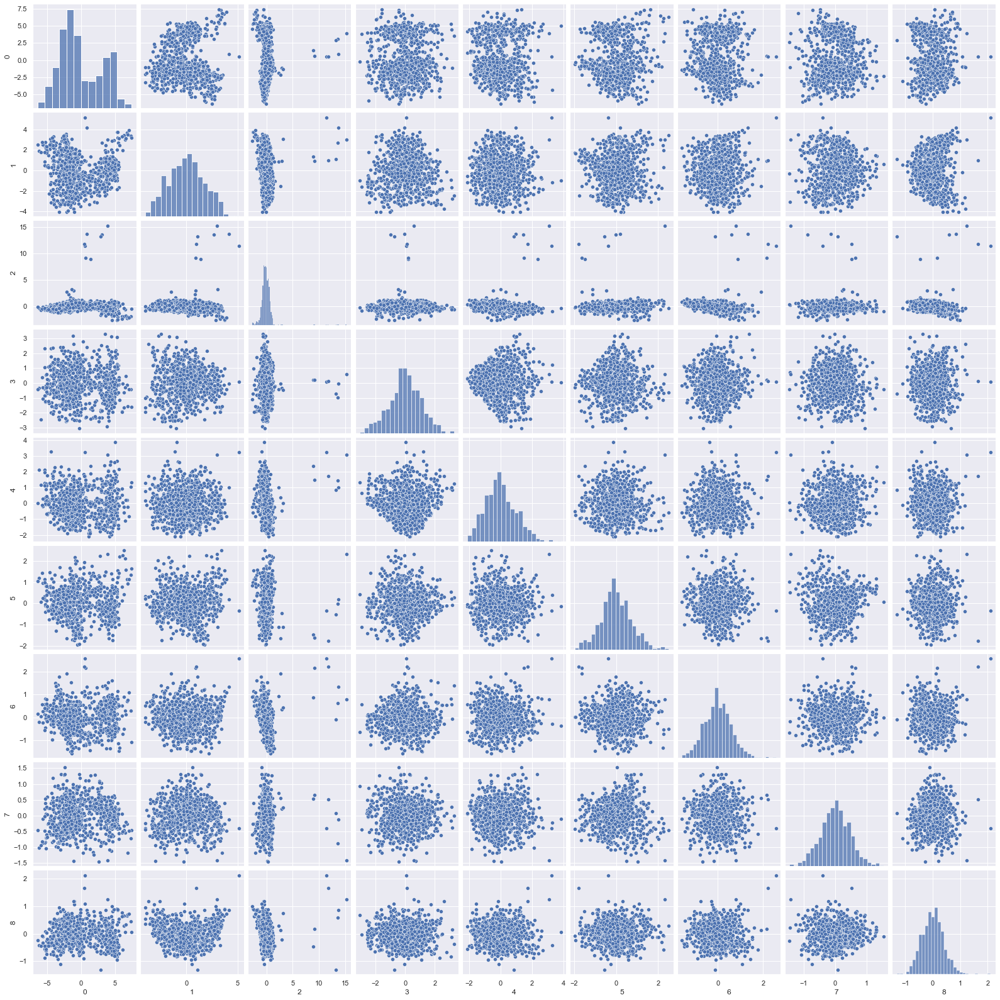

In [94]:
sns.pairplot(pd.DataFrame(Xpca3))


In [95]:

# Training model on all 10 components

clf = svm.SVC(gamma=0.025, C=3) 
clf.fit(XScaled, y)
clf.score(XScaled, y)
   

0.984009840098401

In [96]:
# G. Train SVM model on components selected from above step. [1 Marks]
# Training model on 9 components as per Question F(i)
clf1_pca = svm.SVC(gamma=0.025, C=3) 
clf1_pca.fit(Xpca3, y)
clf1_pca.score(Xpca3, y)
y_pred2 = clf1_pca.predict(Xpca3)
accuracy_score(y , y_pred2)  

0.966789667896679

In [97]:
# H. Print Classification metrics for train data of above model and share insights. [2 Marks]

print(classification_report(y, y_pred2))

              precision    recall  f1-score   support

           0       0.98      0.97      0.97       205
           1       0.98      0.97      0.98       413
           2       0.93      0.96      0.94       195

    accuracy                           0.97       813
   macro avg       0.96      0.97      0.96       813
weighted avg       0.97      0.97      0.97       813



From above result when we selected minimum components of 90 percent means from 10 components we reduced components to 9 as from elbow method optimal number of compnent is <4 then then accuracy is about 96%. For 10 components accuracy is 100%.

# 4. Performance Improvement: [5 Marks]
#    A. Train another SVM on the components out of PCA. Tune the parameters to improve performance. [2 Marks]
#    B. Share best Parameters observed from above step. [1 Marks]
#    C. Print Classification metrics for train data of above model and share relative improvement in performance in all the models along with
#       insights. [2 Marks]

In [98]:
# A. Train another SVM on the components out of PCA. Tune the parameters to improve performance. [2 Marks]



X1 = vehicle.drop(labels= "class" , axis = 1)
y1 = vehicle["class"]
X1.head()

XScaled1=X1.apply(zscore)
XScaled1.head()


X_train, X_test, y_train, y_test = train_test_split(X1, y1, test_size=0.40, random_state=1)


clf = svm.SVC(gamma=0.025, C=3) 
clf.fit(X_train, y_train)

print(clf.score(X_train, y_train))

y_predict = clf.predict(X_test)

print(classification_report(y_test, y_predict))

print(accuracy_score(y_test, y_predict))

print(confusion_matrix(y_test,y_predict))


1.0
              precision    recall  f1-score   support

           0       1.00      0.07      0.14        81
           1       0.55      1.00      0.71       176
           2       1.00      0.03      0.06        69

    accuracy                           0.56       326
   macro avg       0.85      0.37      0.30       326
weighted avg       0.76      0.56      0.43       326

0.5644171779141104
[[  6  75   0]
 [  0 176   0]
 [  0  67   2]]


From above metrics it is conclude that while splitting data in train and test we passed X1 not XScaled1 then our train accuracy is 100% but after building model we are getting less accuracy as just 56% So, now we will split data with XScaled1 and will check accuracy.

In [99]:

X_train, X_test, y_train, y_test = train_test_split(XScaled1, y1, test_size=0.40, random_state=1)

clf = svm.SVC(gamma=0.025, C=3) 
clf.fit(X_train, y_train)

print(clf.score(X_train, y_train))

y_predict = clf.predict(X_test)

print(classification_report(y_test, y_predict))

print(accuracy_score(y_test, y_predict))

print(confusion_matrix(y_test,y_predict))


0.9753593429158111
              precision    recall  f1-score   support

           0       1.00      0.94      0.97        81
           1       0.98      0.97      0.98       176
           2       0.89      0.99      0.94        69

    accuracy                           0.97       326
   macro avg       0.96      0.97      0.96       326
weighted avg       0.97      0.97      0.97       326

0.9662576687116564
[[ 76   2   3]
 [  0 171   5]
 [  0   1  68]]


As expected our test accuracy is very close to train accuracy

In [100]:
# B. Share best Parameters observed from above step. [1 Marks]
# C. Print Classification metrics for train data of above model and share relative improvement in performance in all the models along with
#insights. [2 Marks]

clf = svm.SVC(gamma=0.025, C=3) 
clf.fit(X1, y1)

print(clf.score(X1, y1))

y_predict = clf.predict(X1)

print(classification_report(y1, y_predict))

print(accuracy_score(y1, y_predict))

confusion_matrix(y1,y_predict)

1.0
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       205
           1       1.00      1.00      1.00       413
           2       1.00      1.00      1.00       195

    accuracy                           1.00       813
   macro avg       1.00      1.00      1.00       813
weighted avg       1.00      1.00      1.00       813

1.0


array([[205,   0,   0],
       [  0, 413,   0],
       [  0,   0, 195]], dtype=int64)

In [101]:
# PAssing XScaled1 value to check accuracy

clf = svm.SVC(gamma=0.025, C=3) 
clf.fit(XScaled1, y1)

print(clf.score(XScaled1, y1))

y_predict = clf.predict(XScaled1)

print(classification_report(y1, y_predict))

print(accuracy_score(y1, y_predict))

confusion_matrix(y1,y_predict)

0.984009840098401
              precision    recall  f1-score   support

           0       0.99      0.99      0.99       205
           1       0.99      0.99      0.99       413
           2       0.96      0.98      0.97       195

    accuracy                           0.98       813
   macro avg       0.98      0.98      0.98       813
weighted avg       0.98      0.98      0.98       813

0.984009840098401


array([[202,   0,   3],
       [  2, 407,   4],
       [  1,   3, 191]], dtype=int64)

Best parameters with splitting data in train and test are as follows :
    : Best split is 40% Test and 60% Train
    : Pass Scaled value of X 

Best Parametrs without Splitting data in Train and test are as follows:
    : Passed without scale value of X that is X1 then we will get 100% Accuracy

# C. Print Classification metrics for train data of above model and share relative #improvement in performance in all the models along with insights. [2 Marks]


As already printed classification metrics above now insights on relative improvement in performance in all models.
: Scaling data improves accuracy of model.
: Splitting data in train and test will improves accuracy of model.
: After splitting data we should compare training accuracy with test accuracy. If the both accuracy are close to each other then our model is good otherwise model is overfitting or underfitting.

    

# 5. Data Understanding & Cleaning: [5 Marks]
#    A. Explain pre-requisite/assumptions of PCA. [2 Marks]
#    B. Explain advantages and limitations of PCA. [3 Marks]

Prerequisite of PCA -
- Machine learning fundamentals and feature space
- Linear algebra and statistics

When to use PCA - 
- When you have to reduce the number of features or dimensions in the data.
- When you have to check whether the features are independent of each other or not.

Assumptions : 

• There must be linearity in the data set, i.e. the variables combine in a linear manner to form the dataset. The variables exhibit relationships among themselves.

• PCA assumes that the principal component with high variance must be paid attention and the PCs with lower variance are disregarded as noise. Pearson correlation coefficient framework led to the origin of PCA, and there it was assumed first that the axes with high variance would only be turned into principal components.

• All variables should be accessed on the same ratio level of measurement. The most preferred norm is at least 150 observations of the sample set with a ratio measurement of 5:1.

• Extreme values that deviate from other data points in any dataset, which are also called outliers, should be less. More number of outliers will represent experimental errors and will degrade your ML model/algorithm.

• The feature set must be correlated and the reduced feature set after applying PCA will represent the original data set but in an effective way with fewer dimensions.


Steps involved in PCA -
     a) Standardize the range of continuous initial variables
     b) Compute the covariance matrix to identify correlations
     c) Compute the eigenvectors and eigenvalues of the covariance matrix to identify the principal components
     d) Create a feature vector to decide which principal components to keep
     e) Recast the data along the principal components axes


Applications of PCA

Data is generated in many sectors, and there is a need to analyse data for the growth of any firm/company. PCA will help in reducing the dimensions of the data, thus making it easier to analyse. The applications of PCA are:

• Neuroscience – Neuroscientists use PCA to identify any neuron or to map the brain structure during phase transitions.

• Finance – PCA is used in the finance sector for reducing the dimensionality of data to create fixed income portfolios. Many other facets of the finance sector involve PCA like forecasting returns, making asset allocation algorithms or equity algorithms, etc.

• Image Technology – PCA is also used for image compression or digital image processing. Each image can be represented via a matrix by plotting the intensity values of each pixel, and then we can apply PCA on it.

• Facial Recognition – PCA in facial recognition leads to the creation of eigenfaces which makes facial recognition more accurate.

• Medical – PCA is used on a lot of medical data to find the correlation among different variables. For example, doctors use PCA to show the correlation between cholesterol & low-density lipoprotein.

• Security – Anomalies can be found easily using PCA. It is used to identify cyber/computer attacks and visualise them with the help of PCA.

Advantages of PCA
    a) Removes the correlated attributes.
    b) Help to reduce overfitting.
    c) Improves the data visualization.
    d) It also help to improve the performance of Algorithm,

Disadvantages of PCA
    a) Data normalization must be needed before applying PCA
    b) Some level of information loss.
    c) Independent variables are becoming less interpretable.

Limitations of PCA : 
    a) To apply PCA and produce meaningful results, we must first check whether some assumptions hold, like the presence of linear correlations (e.g., Bartlett’s test of sphericity) or sampling adequacy (e.g., Kaiser-Meyer-Olkin test).
    b) Τhe method relies on linear relationships between the variables in a dataset. So, what if there are correlations but are not linear? 
    c) Another limitation is the assumption of orthogonality, since the principal components are by design orthogonal to each other. Depending on the situation, far “better” basis vectors may exist to summarize the data that are not orthogonal. 
    d) The next gotcha is that large variance is used as a criterion for the existence of structure in the data. However, sometimes structure is found in places with low variance.
    e)  PCA is scale variant. This means that if the variables in our dataset have different units, some variables will dominate the others simply because they assume bigger values, and therefore contribute more to the overall variance. That’s why we typically transform our data so that they have a unit standard deviation.
    f) The point of PCA is to reduce the dimensionality of a dataset. So, how do we decide how many principal components to retain? Approaches often used include visual inspection of the scree plot looking for an “elbow”, keeping components accounting for a fixed amount of the total variance, e.g., 95% of the total variance, or picking components with eigenvalues > 1. However, depending on how robust the analysis needs to be, one should keep in mind that correlations may appear randomly. 
    g) One very important issue is that of interpretability. Once we have replaced our original variables with the principal components, it’s not always entirely trivial to interpret the results.
    h) PCA has a hard time working with missing data and outliers. 